<a href="https://colab.research.google.com/github/samlaujw/video2gif_code/blob/master/sam_video2gif_tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Introduction
This notebook is based off Michael Gygli's tutorial that demonstrates how to generate GIFs from automatically determined video highlights.
To find highlights, they trained a deep neural network to rank segments of videos using the video2gif dataset (https://github.com/gyglim/video2gif_dataset). Their work is described in more depth in their 2016 research paper [1].

The model uses C3D convolutional features [2] as input and is implemented in Lasagne and Theano. 

[1]: M. Gygli, Y. Song, L. Cao - Video2GIF: Automatic Generation of Animated GIFs from Video. CVPR 2016 https://people.ee.ethz.ch/~gyglim/video2gif_cvp16.pdf

[2]: D. Tran, L. Bourdev, R. Fergus, L. Torresani, and M. Paluri, Learning Spatiotemporal Features with 3D Convolutional Networks, ICCV 2015, http://vlg.cs.dartmouth.edu/c3d/c3d_video.pdf

### Preparation steps
Install the video2gif package first, using

    python setup.py install

In [0]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

None
2.7.12 (default, redacted, redacted) 
[GCC 4.2.1 Compatible Clang google3-trunk (trunk r344140)]
sys.version_info(major=2, minor=7, micro=12, releaselevel='final', serial=0)


In [0]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [0]:
!pip install -r https://raw.githubusercontent.com/Lasagne/Lasagne/master/requirements.txt
!pip install https://github.com/Lasagne/Lasagne/archive/master.zip
!pip install theano --upgrade

/bin/sh: pip: command not found
/bin/sh: pip: command not found
/bin/sh: pip: command not found


In [0]:
!pip install imageio
!pip install moviepy

In [0]:
# Import needed modules
from IPython.display import Image, display
import os
from moviepy.editor import VideoFileClip

In [0]:
# Save all files from Video2GIF_Project folder into your own Google Drive before mounting on Colab: 
https://drive.google.com/open?id=1yu45pek4dhixVS0KcVCztSq96xFU3Lri

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
cd /content/drive/My Drive/Video2GIF_Project
!python setup.py install

In [0]:
pwd

u'/content/drive/My Drive/Video2GIF_Project/video2gif_code'

In [0]:
# Import the video2gif package
import video2gif

requires GPU support -- see http://lasagne.readthedocs.org/en/latest/user/installation.html#gpu-support
Loaded config file from video2gif/config.ini


In [0]:
'''
Compile the score function
On the GPU, the network will be using cuDNN layer implementations available in the Lasagne master

If the device is CPU, it will use the CPU version that requires a Lasagne fork with added 3D convolution and pooling.
Get it from https://github.com/gyglim/Lasagne

'''

score_function = video2gif.get_prediction_function()

Load weights and compile model...
Use slow network implementation (without cuDNN)
Load pretrained weights from data/c3d_model.pkl...
Load pretrained autogif_demo weights from data/video2gif_weights.npz...
Set the weights...


In [0]:
'''
Now, let's generate generate some GIFs.
For this we create uniform segment of 3 seconds, score them and
finally generate GIFs from the top and bottom scored ones
'''

# Take the example video
video_path='data/firstman.mp4'
video_name=os.path.splitext(os.path.split(video_path)[1])[0]
video = VideoFileClip(video_path)

# Build segments (uniformly of 3 seconds)
segments = [(start, int(start+video.fps*3)) for start in range(0,int(video.duration*video.fps),int(video.fps*3))]

# Score the segments
scores=video2gif.get_scores(score_function, segments, video, stride=8)        

Score segments...
Extracting scores for 51 segments took 6918.925s



[MoviePy] Building file /tmp/gifs/firstman_00.gif with imageio


100%|██████████| 30/30 [00:02<00:00, 10.57it/s]



[MoviePy] Building file /tmp/gifs/firstman_01.gif with imageio


100%|██████████| 30/30 [00:03<00:00,  9.80it/s]



[MoviePy] Building file /tmp/gifs/firstman_02.gif with imageio


100%|██████████| 30/30 [00:03<00:00,  9.28it/s]



[MoviePy] Building file /tmp/gifs/firstman_03.gif with imageio


100%|██████████| 30/30 [00:02<00:00, 12.61it/s]



[MoviePy] Building file /tmp/gifs/firstman_04.gif with imageio


100%|██████████| 30/30 [00:02<00:00, 11.16it/s]



[MoviePy] Building file /tmp/gifs/firstman_05.gif with imageio


100%|██████████| 30/30 [00:02<00:00,  6.84it/s]



[MoviePy] Building file /tmp/gifs/firstman_06.gif with imageio


100%|██████████| 30/30 [00:03<00:00,  9.15it/s]



[MoviePy] Building file /tmp/gifs/firstman_07.gif with imageio


100%|██████████| 30/30 [00:02<00:00, 13.03it/s]



[MoviePy] Building file /tmp/gifs/firstman_08.gif with imageio


100%|██████████| 30/30 [00:01<00:00, 16.00it/s]



[MoviePy] Building file /tmp/gifs/firstman_09.gif with imageio


100%|██████████| 30/30 [00:03<00:00,  9.92it/s]



[MoviePy] Building file /tmp/gifs/firstman_51.gif with imageio


100%|██████████| 30/30 [00:01<00:00, 25.18it/s]



[MoviePy] Building file /tmp/gifs/firstman_50.gif with imageio


100%|██████████| 30/30 [00:00<00:00, 31.27it/s]



[MoviePy] Building file /tmp/gifs/firstman_49.gif with imageio


100%|██████████| 30/30 [00:01<00:00, 17.78it/s]


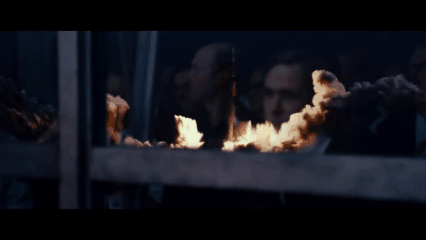

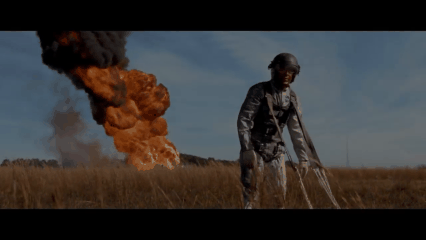

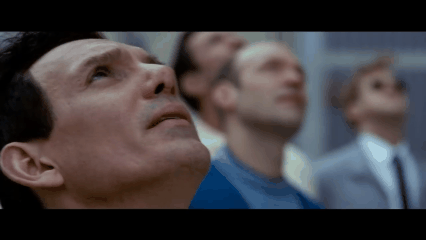

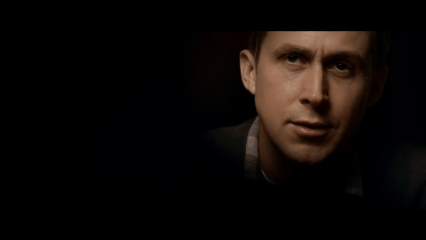

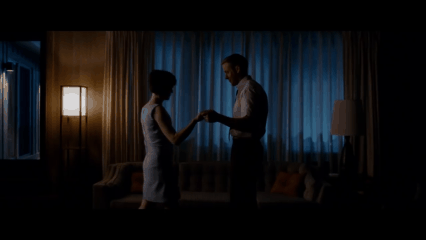

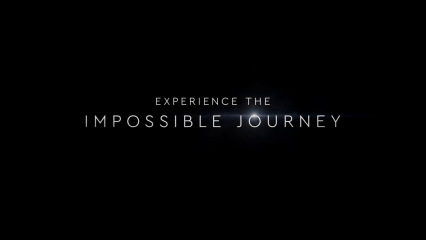

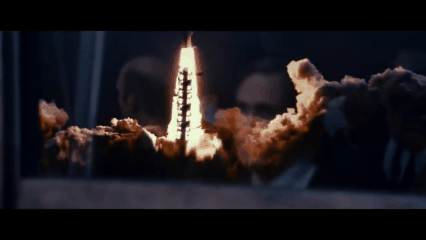

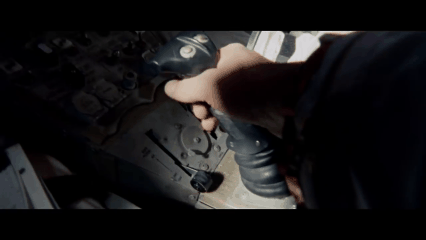

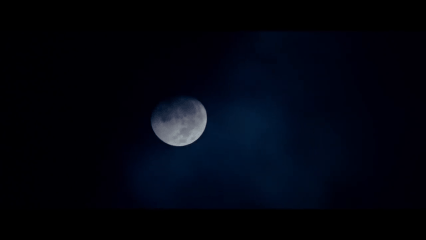

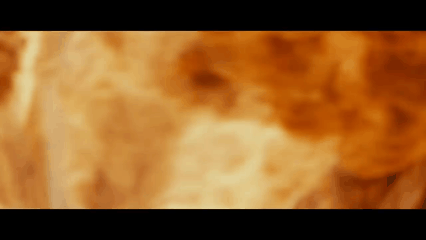

In [0]:
'''
Now we generate GIFs for some segments and show them
'''

# We need a directory to store the GIFs
OUT_DIR='/tmp/gifs'
if not os.path.exists(OUT_DIR):
    os.mkdir(OUT_DIR)

# Generate GIFs from the top scoring segments
good_gifs,bad_gifs = video2gif.generate_gifs(OUT_DIR,scores, video, video_name,top_k=10,bottom_k=3)

# Show them in the jupyter notebook
for gif_data in good_gifs: # Top GIFs
    gif_data[1]
    gif_path='%s/%s_%.2d.gif' % (OUT_DIR,video_name,gif_data[1])
    with open(gif_path,'rb') as f:
        #display(Image(f.read()), format='png')
        display(Image(f.read()))

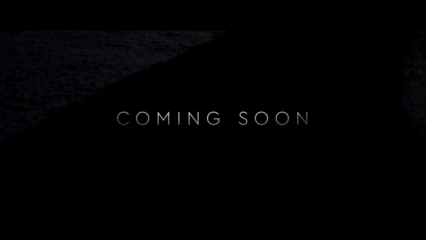

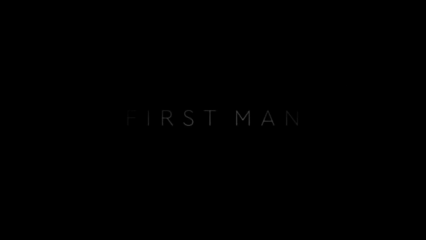

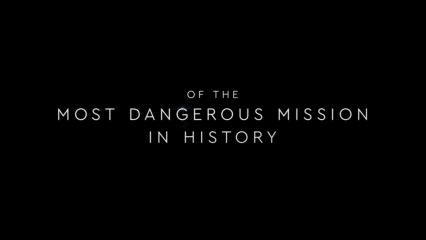

In [0]:
# Now, for comparison, we show the GIFs with the worst scores
for gif_data in bad_gifs: 
    gif_data[1]
    gif_path='%s/%s_%.2d.gif' % (OUT_DIR,video_name,gif_data[1])
    with open(gif_path,'rb') as f:
        #display(Image(f.read()), format='png')
        display(Image(f.read()))